In [1]:
import pandas as pd
import matplotlib.pyplot as plt 
import os
import base64
from requests import post, get
import json
import time
import pandas as pd
import numpy as np

In [ ]:
df = pd.read_csv('final_dataset.csv')
df.drop('Unnamed: 0.1',axis=1,inplace=True)

In [ ]:
df

,id,name,artists,artistid,explicit,popularity,durationms,year,genres,danceability,acousticness,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
0,3w3y8KPTfNeOKPiqUTakBh,Locked out of Heaven,['Bruno Mars'],0du5cEVh5yTK9QJze8zA0C,False,84,233478,2012,"['dance pop', 'pop']",0.726,0.04900,0.698,0.000000,0.3090,-4.165,0.0431,143.994,0.867
1,3TGRqZ0a2l1LRblBkJoaDx,Call Me Maybe,['Carly Rae Jepsen'],6sFIWsNpZYqfjUpaCgueju,False,69,193400,2012,"['canadian pop', 'dance pop', 'electropop', 'p...",0.783,0.01140,0.580,0.000002,0.1080,-6.548,0.0408,120.021,0.660
2,7a86XRg84qjasly9f6bPSD,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']",5nCi3BB41mBaMH9gfr6Su0,False,70,250626,2012,"['baroque pop', 'metropopolis', 'modern rock',...",0.378,0.02000,0.638,0.000077,0.0849,-5.576,0.0750,184.086,0.735
3,1z9kQ14XBSN0r2v6fx4IdG,Diamonds,['Rihanna'],5pKCCKE2ajJHZ9KAiaK11H,False,67,225146,2012,"['barbadian pop', 'dance pop', 'pop', 'urban c...",0.564,0.00125,0.710,0.000000,0.1090,-4.920,0.0461,91.972,0.393
4,3GZD6HmiNUhxXYf8Gch723,Lost,['Frank Ocean'],2h93pZq0e7k5yf4dywlkpM,True,81,234093,2012,"['hip hop', 'lgbtq+ hip hop', 'neo soul', 'pop']",0.913,0.02720,0.603,0.000503,0.1670,-4.892,0.2260,123.061,0.497
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095,2g6tReTlM2Akp41g0HaeXN,Die Hard,"['Kendrick Lamar', 'Blxst', 'Amanda Reifer']",2YZyLoL8N0Wb9xBt1NhZWg,True,76,239026,2022,"['conscious hip hop', 'hip hop', 'rap', 'west ...",0.775,0.31900,0.736,0.001160,0.1270,-8.072,0.2470,100.988,0.362
1096,4pi1G1x8tl9VfdD9bL3maT,Big Energy,['Latto'],3MdXrJWsbVzdn6fe5JYkSQ,True,65,172540,2022,"['pop', 'rap', 'trap queen']",0.937,0.04530,0.793,0.000000,0.3410,-4.431,0.1150,106.022,0.794
1097,3LtpKP5abr2qqjunvjlX5i,Doja,['Central Cee'],5H4yInM5zmHqpKIoMNAx4r,True,84,97392,2022,['melodic drill'],0.911,0.38000,0.573,0.000000,0.4030,-7.430,0.2880,140.040,0.972
1098,3XOalgusokruzA5ZBA2Qcb,pushin P (feat. Young Thug),"['Gunna', 'Future', 'Young Thug']",2hlmm7s2ICUX0LVIhVFlZQ,True,74,136266,2022,"['atl hip hop', 'hip hop', 'melodic rap', 'rap...",0.773,0.00783,0.422,0.006930,0.1290,-4.572,0.1870,77.502,0.488


In [ ]:
df_new = df[['id','name','artists']]

In [ ]:
df_new

,id,name,artists
0,3w3y8KPTfNeOKPiqUTakBh,Locked out of Heaven,['Bruno Mars']
1,3TGRqZ0a2l1LRblBkJoaDx,Call Me Maybe,['Carly Rae Jepsen']
2,7a86XRg84qjasly9f6bPSD,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']"
3,1z9kQ14XBSN0r2v6fx4IdG,Diamonds,['Rihanna']
4,3GZD6HmiNUhxXYf8Gch723,Lost,['Frank Ocean']
...,...,...,...
1095,2g6tReTlM2Akp41g0HaeXN,Die Hard,"['Kendrick Lamar', 'Blxst', 'Amanda Reifer']"
1096,4pi1G1x8tl9VfdD9bL3maT,Big Energy,['Latto']
1097,3LtpKP5abr2qqjunvjlX5i,Doja,['Central Cee']
1098,3XOalgusokruzA5ZBA2Qcb,pushin P (feat. Young Thug),"['Gunna', 'Future', 'Young Thug']"


In [ ]:
auth = "XFamdXE_l7p81is1WCKWZV5HtrHuh2Ue-UE93QvSzsDtjfjeQfLD7PfzVyXXiZVU"

In [ ]:
def request_song_info(track_name, track_artist,genius_key):
    track_name = track_name
    track_artist = track_artist
    base_url = 'https://api.genius.com'
    headers = {'Authorization': 'Bearer ' + genius_key}
    search_url = base_url + '/search'
    data = {'q': track_name + ' ' + track_artist}
    response = get(search_url, data=data, headers=headers)
    return response.json()

In [ ]:
for i in range(len(df_new)):
  id = df_new.iloc[i]['id']
  track_name = df_new.iloc[i]['name']
  artist = df_new.iloc[i]['artists'].split("'")[1]
  j = request_song_info(track_name,artist,auth)
  with open(f"{id}.json", "w") as outfile:
    json.dump(j, outfile)

KeyboardInterrupt: ignored

In [ ]:
!pip install lyricsgenius

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.4/59.4 KB 5.8 MB/s eta 0:00:00


In [ ]:
from lyricsgenius import Genius

In [ ]:
genius = Genius(auth)
song = genius.search_song("Forever", 'Drake')

# Way 2
# this will search artist.songs first
# and if not found, uses search_song
song = artist.song("Forever")

print(song.lyrics)

Searching for "Forever" by Drake...


HTTPError: ignored

In [ ]:
import os 
li = os.listdir('/content')

In [ ]:
del li[0]

In [ ]:
for i in enumerate(li):
  f = open("/content/"+i[1])
  data = json.load(f)
  print(data['response']['hits'][0]['result']['url'])

https://genius.com/The-neighbourhood-daddy-issues-lyrics
https://genius.com/Jessie-j-ariana-grande-and-nicki-minaj-bang-bang-lyrics
https://genius.com/Elle-king-exs-and-ohs-lyrics
https://genius.com/The-weeknd-starboy-lyrics
https://genius.com/Brit-awards-2016-winners-and-nominees-lyrics
https://genius.com/Top-40-songteksten-week-25-20-juni-2015-lyrics
https://genius.com/Ed-sheeran-i-see-fire-lyrics
https://genius.com/Marshmello-alone-lyrics
https://genius.com/The-chainsmokers-selfie-lyrics
https://genius.com/Spotify-new-music-tuesday-04-14-15-annotated
https://genius.com/Onerepublic-love-runs-out-lyrics
https://genius.com/Spotify-this-is-2-chainz-lyrics
https://genius.com/Nicki-minaj-starships-lyrics
https://genius.com/Brit-awards-2015-winners-and-nominees-lyrics
https://genius.com/Twenty-one-pilots-ride-lyrics
https://genius.com/One-direction-live-while-were-young-lyrics
https://genius.com/Post-malone-white-iverson-lyrics
https://genius.com/James-bay-let-it-go-lyrics
https://genius.c

IndexError: ignored

In [ ]:
df.isnull().values.any()

False

In [ ]:
df.describe()

,popularity,durationms,year,danceability,acousticness,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
count,1100.000000,1100.00000,1100.000000,1100.000000,1100.000000,1100.000000,1100.000000,1100.000000,1100.000000,1100.000000,1100.000000,1100.000000
mean,70.113636,213461.30000,2017.000000,0.673775,0.183298,0.655626,0.008887,0.168172,-6.015954,0.099044,120.058624,0.495840
std,12.868015,40137.46216,3.163716,0.134288,0.222855,0.163199,0.064898,0.125688,2.106153,0.093070,27.129120,0.223763
min,0.000000,97392.00000,2012.000000,0.188000,0.000013,0.051900,0.000000,0.021000,-21.107000,0.023200,64.934000,0.038100
25%,67.000000,188806.00000,2014.000000,0.591000,0.022250,0.548000,0.000000,0.092350,-7.088000,0.041300,99.710750,0.326750
50%,72.000000,210577.50000,2017.000000,0.687000,0.089200,0.673000,0.000000,0.117000,-5.695000,0.058950,119.976000,0.488000
75%,77.000000,232136.50000,2020.000000,0.772250,0.258250,0.783000,0.000042,0.204000,-4.571250,0.107000,135.003250,0.668750
max,94.000000,613026.00000,2022.000000,0.965000,0.978000,0.972000,0.896000,0.979000,-1.702000,0.530000,205.863000,0.972000


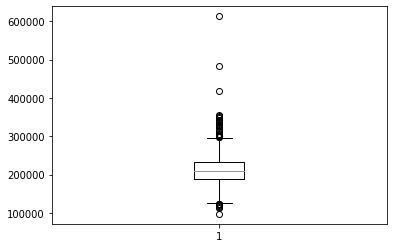

In [ ]:
plt.boxplot(df['durationms'])
plt.show()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1100 entries, 0 to 1099
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                1100 non-null   object 
 1   name              1100 non-null   object 
 2   artists           1100 non-null   object 
 3   artistid          1100 non-null   object 
 4   explicit          1100 non-null   bool   
 5   popularity        1100 non-null   int64  
 6   durationms        1100 non-null   int64  
 7   year              1100 non-null   int64  
 8   genres            1100 non-null   object 
 9   danceability      1100 non-null   float64
 10  acousticness      1100 non-null   float64
 11  energy            1100 non-null   float64
 12  instrumentalness  1100 non-null   float64
 13  liveness          1100 non-null   float64
 14  loudness          1100 non-null   float64
 15  speechiness       1100 non-null   float64
 16  tempo             1100 non-null   float64


In [ ]:
df['explicit'].value_counts()

False    736
True     364
Name: explicit, dtype: int64

In [ ]:
!pip install ydata_profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 344.5/344.5 KB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 KB 53.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 KB 11.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 118.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 112.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 KB 34.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=cdd1b4a9f08d22f5d624673675d1c6116b1ff2afdf80478cf6a4816795d5b414
  Stored in directory: /root/.cache/pip/wheels/23/14/6e/4be5bfeeb027f4939a01764b48edd5996acf574b0913fe5243
Successfully built htmlmin
  Attempting uninstall: typeguard
    Found existing installation: typeguard 2.7.1
    Un

In [ ]:
df2

,explicit,popularity,durationms,year,danceability,acousticness,energy,instrumentalness,liveness,loudness,...,justinbieber,kendricklamar,khalid,nickiminaj,postmalone,rihanna,selenagomez,shawnmendes,taylorswift,theweeknd
0,False,84,233478,2012,0.726,0.04900,0.698,0.000000,0.3090,-4.165,...,0,0,0,0,0,0,0,0,0,0
1,False,69,193400,2012,0.783,0.01140,0.580,0.000002,0.1080,-6.548,...,0,0,0,0,0,0,0,0,0,0
2,False,70,250626,2012,0.378,0.02000,0.638,0.000077,0.0849,-5.576,...,0,0,0,0,0,0,0,0,0,0
3,False,67,225146,2012,0.564,0.00125,0.710,0.000000,0.1090,-4.920,...,0,0,0,0,0,1,0,0,0,0
4,True,81,234093,2012,0.913,0.02720,0.603,0.000503,0.1670,-4.892,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,True,76,239026,2022,0.775,0.31900,0.736,0.001160,0.1270,-8.072,...,0,1,0,0,0,0,0,0,0,0
1043,True,65,172540,2022,0.937,0.04530,0.793,0.000000,0.3410,-4.431,...,0,0,0,0,0,0,0,0,0,0
1044,True,84,97392,2022,0.911,0.38000,0.573,0.000000,0.4030,-7.430,...,0,0,0,0,0,0,0,0,0,0
1045,True,74,136266,2022,0.773,0.00783,0.422,0.006930,0.1290,-4.572,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df2, title="Profiling Report")

In [ ]:
profile.to_widgets()

/usr/local/lib/python3.8/dist-packages/ydata_profiling/profile_report.py:495: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_file("your_report_cleaned.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
import pandas as pd 
import numpy as np 
df = pd .read_csv("final_dataset.csv")

In [ ]:
df.isnull().values.any()

False

In [ ]:
df = df.drop_duplicates(subset="id")

In [ ]:
new_df = df[['id','genres']]

In [ ]:
new_df

,id,genres
0,3w3y8KPTfNeOKPiqUTakBh,"['dance pop', 'pop']"
1,3TGRqZ0a2l1LRblBkJoaDx,"['canadian pop', 'dance pop', 'electropop', 'p..."
2,7a86XRg84qjasly9f6bPSD,"['baroque pop', 'metropopolis', 'modern rock',..."
3,1z9kQ14XBSN0r2v6fx4IdG,"['barbadian pop', 'dance pop', 'pop', 'urban c..."
4,3GZD6HmiNUhxXYf8Gch723,"['hip hop', 'lgbtq+ hip hop', 'neo soul', 'pop']"
...,...,...
1095,2g6tReTlM2Akp41g0HaeXN,"['conscious hip hop', 'hip hop', 'rap', 'west ..."
1096,4pi1G1x8tl9VfdD9bL3maT,"['pop', 'rap', 'trap queen']"
1097,3LtpKP5abr2qqjunvjlX5i,['melodic drill']
1098,3XOalgusokruzA5ZBA2Qcb,"['atl hip hop', 'hip hop', 'melodic rap', 'rap..."


In [ ]:
type(new_df['genres'][0])

str

In [ ]:
import ast

In [ ]:
def convert(obj):
  L = []
  for i in ast.literal_eval(obj):
    L.append(i)
  return L

In [ ]:
new_df['genres'] = new_df['genres'].apply(convert)

<ipython-input-109-e745cef54c97>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['genres'] = new_df['genres'].apply(convert)


In [ ]:
new_df['genres'] = new_df['genres'].apply(lambda x:[i.replace(" ","") for i in x])

<ipython-input-110-58a6b9649e9b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['genres'] = new_df['genres'].apply(lambda x:[i.replace(" ","") for i in x])


In [ ]:
new_df['genres'] = new_df['genres'].apply(lambda x:" ".join(x))

<ipython-input-111-1995e158a547>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['genres'] = new_df['genres'].apply(lambda x:" ".join(x))


In [ ]:
new_df['genres'] = new_df['genres'].apply(lambda x:x.lower())

<ipython-input-112-92739a89159a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['genres'] = new_df['genres'].apply(lambda x:x.lower())


In [ ]:
new_df

,id,genres
0,3w3y8KPTfNeOKPiqUTakBh,dancepop pop
1,3TGRqZ0a2l1LRblBkJoaDx,canadianpop dancepop electropop pop post-teenpop
2,7a86XRg84qjasly9f6bPSD,baroquepop metropopolis modernrock poprock
3,1z9kQ14XBSN0r2v6fx4IdG,barbadianpop dancepop pop urbancontemporary
4,3GZD6HmiNUhxXYf8Gch723,hiphop lgbtq+hiphop neosoul pop
...,...,...
1095,2g6tReTlM2Akp41g0HaeXN,conscioushiphop hiphop rap westcoastrap
1096,4pi1G1x8tl9VfdD9bL3maT,pop rap trapqueen
1097,3LtpKP5abr2qqjunvjlX5i,melodicdrill
1098,3XOalgusokruzA5ZBA2Qcb,atlhiphop hiphop melodicrap rap trap


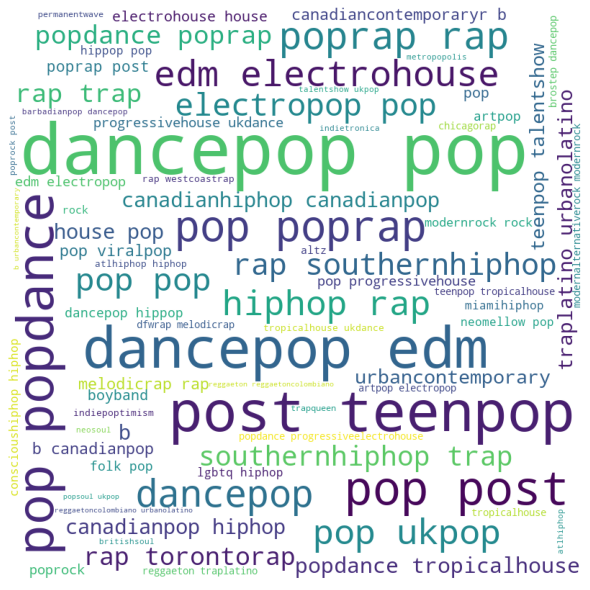

In [ ]:
from wordcloud import WordCloud, STOPWORDS
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                min_font_size = 10).generate(" ".join(new_df['genres']))
                # plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

In [ ]:
cv = CountVectorizer(max_features=5)

In [ ]:
vectors = cv.fit_transform(new_df['genres']).toarray()

In [ ]:
cv.get_feature_names()

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


['dancepop', 'edm', 'pop', 'poprap', 'rap']

In [ ]:
bag_of_words = pd.DataFrame(vectors,columns=cv.get_feature_names())

In [ ]:
bag_of_words

,dancepop,edm,pop,poprap,rap
0,1,0,1,0,0
1,1,0,1,0,0
2,0,0,0,0,0
3,1,0,1,0,0
4,0,0,1,0,0
...,...,...,...,...,...
1042,0,0,0,0,1
1043,0,0,1,0,1
1044,0,0,0,0,0
1045,0,0,0,0,1


In [ ]:
bag_of_words['id'] = new_df['id']

In [ ]:
new_df = new_df.drop_duplicates(subset=['id'])

In [ ]:
bag_of_words = bag_of_words.drop_duplicates(subset=['id'])

In [ ]:
new_df = pd.merge(new_df,bag_of_words,on="id",how='left')

In [ ]:
new_df

,id,genres,dancepop,edm,pop,poprap,rap
0,3w3y8KPTfNeOKPiqUTakBh,dancepop pop,1.0,0.0,1.0,0.0,0.0
1,3TGRqZ0a2l1LRblBkJoaDx,canadianpop dancepop electropop pop post-teenpop,1.0,0.0,1.0,0.0,0.0
2,7a86XRg84qjasly9f6bPSD,baroquepop metropopolis modernrock poprock,0.0,0.0,0.0,0.0,0.0
3,1z9kQ14XBSN0r2v6fx4IdG,barbadianpop dancepop pop urbancontemporary,1.0,0.0,1.0,0.0,0.0
4,3GZD6HmiNUhxXYf8Gch723,hiphop lgbtq+hiphop neosoul pop,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...
1042,2g6tReTlM2Akp41g0HaeXN,conscioushiphop hiphop rap westcoastrap,NaN,NaN,NaN,NaN,NaN
1043,4pi1G1x8tl9VfdD9bL3maT,pop rap trapqueen,NaN,NaN,NaN,NaN,NaN
1044,3LtpKP5abr2qqjunvjlX5i,melodicdrill,NaN,NaN,NaN,NaN,NaN
1045,3XOalgusokruzA5ZBA2Qcb,atlhiphop hiphop melodicrap rap trap,NaN,NaN,NaN,NaN,NaN


In [ ]:
df = df.drop_duplicates(subset=['id'])

In [ ]:
new_df = pd.merge(df,new_df,on='id')

In [ ]:
new_df

,id,Unnamed: 0.1,name,artists,artistid,explicit,popularity,durationms,year,genres_x,...,loudness,speechiness,tempo,valence,genres_y,dancepop,edm,pop,poprap,rap
0,3w3y8KPTfNeOKPiqUTakBh,0,Locked out of Heaven,['Bruno Mars'],0du5cEVh5yTK9QJze8zA0C,False,84,233478,2012,"['dance pop', 'pop']",...,-4.165,0.0431,143.994,0.867,dancepop pop,1.0,0.0,1.0,0.0,0.0
1,3TGRqZ0a2l1LRblBkJoaDx,1,Call Me Maybe,['Carly Rae Jepsen'],6sFIWsNpZYqfjUpaCgueju,False,69,193400,2012,"['canadian pop', 'dance pop', 'electropop', 'p...",...,-6.548,0.0408,120.021,0.660,canadianpop dancepop electropop pop post-teenpop,1.0,0.0,1.0,0.0,0.0
2,7a86XRg84qjasly9f6bPSD,2,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']",5nCi3BB41mBaMH9gfr6Su0,False,70,250626,2012,"['baroque pop', 'metropopolis', 'modern rock',...",...,-5.576,0.0750,184.086,0.735,baroquepop metropopolis modernrock poprock,0.0,0.0,0.0,0.0,0.0
3,1z9kQ14XBSN0r2v6fx4IdG,3,Diamonds,['Rihanna'],5pKCCKE2ajJHZ9KAiaK11H,False,67,225146,2012,"['barbadian pop', 'dance pop', 'pop', 'urban c...",...,-4.920,0.0461,91.972,0.393,barbadianpop dancepop pop urbancontemporary,1.0,0.0,1.0,0.0,0.0
4,3GZD6HmiNUhxXYf8Gch723,4,Lost,['Frank Ocean'],2h93pZq0e7k5yf4dywlkpM,True,81,234093,2012,"['hip hop', 'lgbtq+ hip hop', 'neo soul', 'pop']",...,-4.892,0.2260,123.061,0.497,hiphop lgbtq+hiphop neosoul pop,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,2g6tReTlM2Akp41g0HaeXN,1095,Die Hard,"['Kendrick Lamar', 'Blxst', 'Amanda Reifer']",2YZyLoL8N0Wb9xBt1NhZWg,True,76,239026,2022,"['conscious hip hop', 'hip hop', 'rap', 'west ...",...,-8.072,0.2470,100.988,0.362,conscioushiphop hiphop rap westcoastrap,NaN,NaN,NaN,NaN,NaN
1043,4pi1G1x8tl9VfdD9bL3maT,1096,Big Energy,['Latto'],3MdXrJWsbVzdn6fe5JYkSQ,True,65,172540,2022,"['pop', 'rap', 'trap queen']",...,-4.431,0.1150,106.022,0.794,pop rap trapqueen,NaN,NaN,NaN,NaN,NaN
1044,3LtpKP5abr2qqjunvjlX5i,1097,Doja,['Central Cee'],5H4yInM5zmHqpKIoMNAx4r,True,84,97392,2022,['melodic drill'],...,-7.430,0.2880,140.040,0.972,melodicdrill,NaN,NaN,NaN,NaN,NaN
1045,3XOalgusokruzA5ZBA2Qcb,1098,pushin P (feat. Young Thug),"['Gunna', 'Future', 'Young Thug']",2hlmm7s2ICUX0LVIhVFlZQ,True,74,136266,2022,"['atl hip hop', 'hip hop', 'melodic rap', 'rap...",...,-4.572,0.1870,77.502,0.488,atlhiphop hiphop melodicrap rap trap,NaN,NaN,NaN,NaN,NaN


In [ ]:
len(new_df)

1047

In [ ]:
new_df.to_csv('cleaned_dataset.csv')

In [ ]:
cleaned_dataset = pd.read_csv('cleaned_dataset.csv')

In [ ]:
cleaned_dataset

,Unnamed: 0,id,Unnamed: 0.1,name,artists,artistid,explicit,popularity,durationms,year,...,loudness,speechiness,tempo,valence,genres_y,dancepop,edm,pop,poprap,rap
0,0,3w3y8KPTfNeOKPiqUTakBh,0,Locked out of Heaven,['Bruno Mars'],0du5cEVh5yTK9QJze8zA0C,False,84,233478,2012,...,-4.165,0.0431,143.994,0.867,dancepop pop,1.0,0.0,1.0,0.0,0.0
1,1,3TGRqZ0a2l1LRblBkJoaDx,1,Call Me Maybe,['Carly Rae Jepsen'],6sFIWsNpZYqfjUpaCgueju,False,69,193400,2012,...,-6.548,0.0408,120.021,0.660,canadianpop dancepop electropop pop post-teenpop,1.0,0.0,1.0,0.0,0.0
2,2,7a86XRg84qjasly9f6bPSD,2,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']",5nCi3BB41mBaMH9gfr6Su0,False,70,250626,2012,...,-5.576,0.0750,184.086,0.735,baroquepop metropopolis modernrock poprock,0.0,0.0,0.0,0.0,0.0
3,3,1z9kQ14XBSN0r2v6fx4IdG,3,Diamonds,['Rihanna'],5pKCCKE2ajJHZ9KAiaK11H,False,67,225146,2012,...,-4.920,0.0461,91.972,0.393,barbadianpop dancepop pop urbancontemporary,1.0,0.0,1.0,0.0,0.0
4,4,3GZD6HmiNUhxXYf8Gch723,4,Lost,['Frank Ocean'],2h93pZq0e7k5yf4dywlkpM,True,81,234093,2012,...,-4.892,0.2260,123.061,0.497,hiphop lgbtq+hiphop neosoul pop,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,1042,2g6tReTlM2Akp41g0HaeXN,1095,Die Hard,"['Kendrick Lamar', 'Blxst', 'Amanda Reifer']",2YZyLoL8N0Wb9xBt1NhZWg,True,76,239026,2022,...,-8.072,0.2470,100.988,0.362,conscioushiphop hiphop rap westcoastrap,NaN,NaN,NaN,NaN,NaN
1043,1043,4pi1G1x8tl9VfdD9bL3maT,1096,Big Energy,['Latto'],3MdXrJWsbVzdn6fe5JYkSQ,True,65,172540,2022,...,-4.431,0.1150,106.022,0.794,pop rap trapqueen,NaN,NaN,NaN,NaN,NaN
1044,1044,3LtpKP5abr2qqjunvjlX5i,1097,Doja,['Central Cee'],5H4yInM5zmHqpKIoMNAx4r,True,84,97392,2022,...,-7.430,0.2880,140.040,0.972,melodicdrill,NaN,NaN,NaN,NaN,NaN
1045,1045,3XOalgusokruzA5ZBA2Qcb,1098,pushin P (feat. Young Thug),"['Gunna', 'Future', 'Young Thug']",2hlmm7s2ICUX0LVIhVFlZQ,True,74,136266,2022,...,-4.572,0.1870,77.502,0.488,atlhiphop hiphop melodicrap rap trap,NaN,NaN,NaN,NaN,NaN


In [ ]:
cleaned_dataset.drop('Unnamed: 0.1',axis=1,inplace=True)

In [ ]:
cleaned_dataset.isnull().values.any()

True

In [ ]:
cleaned_dataset

,id,name,artists,artistid,explicit,popularity,durationms,year,genres_x,danceability,...,loudness,speechiness,tempo,valence,genres_y,dancepop,edm,pop,poprap,rap
0,3w3y8KPTfNeOKPiqUTakBh,Locked out of Heaven,['Bruno Mars'],0du5cEVh5yTK9QJze8zA0C,False,84,233478,2012,"['dance pop', 'pop']",0.726,...,-4.165,0.0431,143.994,0.867,dancepop pop,1.0,0.0,1.0,0.0,0.0
1,3TGRqZ0a2l1LRblBkJoaDx,Call Me Maybe,['Carly Rae Jepsen'],6sFIWsNpZYqfjUpaCgueju,False,69,193400,2012,"['canadian pop', 'dance pop', 'electropop', 'p...",0.783,...,-6.548,0.0408,120.021,0.660,canadianpop dancepop electropop pop post-teenpop,1.0,0.0,1.0,0.0,0.0
2,7a86XRg84qjasly9f6bPSD,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']",5nCi3BB41mBaMH9gfr6Su0,False,70,250626,2012,"['baroque pop', 'metropopolis', 'modern rock',...",0.378,...,-5.576,0.0750,184.086,0.735,baroquepop metropopolis modernrock poprock,0.0,0.0,0.0,0.0,0.0
3,1z9kQ14XBSN0r2v6fx4IdG,Diamonds,['Rihanna'],5pKCCKE2ajJHZ9KAiaK11H,False,67,225146,2012,"['barbadian pop', 'dance pop', 'pop', 'urban c...",0.564,...,-4.920,0.0461,91.972,0.393,barbadianpop dancepop pop urbancontemporary,1.0,0.0,1.0,0.0,0.0
4,3GZD6HmiNUhxXYf8Gch723,Lost,['Frank Ocean'],2h93pZq0e7k5yf4dywlkpM,True,81,234093,2012,"['hip hop', 'lgbtq+ hip hop', 'neo soul', 'pop']",0.913,...,-4.892,0.2260,123.061,0.497,hiphop lgbtq+hiphop neosoul pop,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,2g6tReTlM2Akp41g0HaeXN,Die Hard,"['Kendrick Lamar', 'Blxst', 'Amanda Reifer']",2YZyLoL8N0Wb9xBt1NhZWg,True,76,239026,2022,"['conscious hip hop', 'hip hop', 'rap', 'west ...",0.775,...,-8.072,0.2470,100.988,0.362,conscioushiphop hiphop rap westcoastrap,NaN,NaN,NaN,NaN,NaN
1043,4pi1G1x8tl9VfdD9bL3maT,Big Energy,['Latto'],3MdXrJWsbVzdn6fe5JYkSQ,True,65,172540,2022,"['pop', 'rap', 'trap queen']",0.937,...,-4.431,0.1150,106.022,0.794,pop rap trapqueen,NaN,NaN,NaN,NaN,NaN
1044,3LtpKP5abr2qqjunvjlX5i,Doja,['Central Cee'],5H4yInM5zmHqpKIoMNAx4r,True,84,97392,2022,['melodic drill'],0.911,...,-7.430,0.2880,140.040,0.972,melodicdrill,NaN,NaN,NaN,NaN,NaN
1045,3XOalgusokruzA5ZBA2Qcb,pushin P (feat. Young Thug),"['Gunna', 'Future', 'Young Thug']",2hlmm7s2ICUX0LVIhVFlZQ,True,74,136266,2022,"['atl hip hop', 'hip hop', 'melodic rap', 'rap...",0.773,...,-4.572,0.1870,77.502,0.488,atlhiphop hiphop melodicrap rap trap,NaN,NaN,NaN,NaN,NaN


In [ ]:
for i in cleaned_dataset.columns:
  print(i+":",cleaned_dataset[i].isnull().values.any())

id: False
name: False
artists: False
artistid: False
explicit: False
popularity: False
durationms: False
year: False
genres_x: False
danceability: False
acousticness: False
energy: False
instrumentalness: False
liveness: False
loudness: False
speechiness: False
tempo: False
valence: False
genres_y: True
dancepop: True
edm: True
pop: True
poprap: True
rap: True


In [ ]:
cleaned_dataset[cleaned_dataset['genres_y'].isnull()]

,id,Unnamed: 0.1,name,artists,artistid,explicit,popularity,durationms,year,genres_x,...,loudness,speechiness,tempo,valence,genres_y,dancepop,edm,pop,poprap,rap
262,7ioiB40H9xKs04QtIso2I3,273,Somebody,"['Natalie La Rose', 'Jeremih']",2qdONMCoDngQk0eV4Avs1i,False,64,189906,2014,[],...,-8.714,0.0376,104.990,0.735,NaN,0.0,0.0,0.0,0.0,0.0
733,0hVXuCcriWRGvwMV1r5Yn9,771,I Don't Care (with Justin Bieber),"['Ed Sheeran & Justin Bieber', 'Justin Bieber']",1WsYCXdezMjn0KoIrLvMmC,False,70,219946,2019,[],...,-5.041,0.0442,101.956,0.843,NaN,0.0,0.0,0.0,0.0,0.0
819,39Yp9wwQiSRIDOvrVg7mbk,860,THE SCOTTS,"['THE SCOTTS', 'Travis Scott', 'Kid Cudi']",2PaZWGu5T5nHjY2xxAkFsT,True,72,165977,2020,[],...,-7.648,0.0514,129.979,0.280,NaN,0.0,0.0,1.0,0.0,0.0
947,3nY8AqaMNNHHLYV4380ol0,998,Dick (feat. Doja Cat),"['StarBoi3', 'Doja Cat']",2WgfkM8S11vg4kxLgDY3F5,True,67,175238,2021,[],...,-6.831,0.4200,125.994,0.474,NaN,0.0,0.0,1.0,0.0,0.0


In [ ]:
cleaned_dataset.drop(["genres_x","genres_y"],axis=1,inplace=True)

In [ ]:
for i in cleaned_dataset.columns:
  print(i+":",cleaned_dataset[i].isnull().values.any())

id: False
name: False
artists: False
artistid: False
explicit: False
popularity: False
durationms: False
year: False
danceability: False
acousticness: False
energy: False
instrumentalness: False
liveness: False
loudness: False
speechiness: False
tempo: False
valence: False
dancepop: False
edm: False
pop: False
poprap: False
rap: False


In [ ]:
cleaned_dataset = cleaned_dataset.fillna(0)

In [ ]:
cleaned_dataset.to_csv('cleaned_dataset.csv')

In [ ]:
df = pd.read_csv('cleaned_dataset.csv')

In [ ]:
df.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
df.head(5)

,id,name,artists,artistid,explicit,popularity,durationms,year,danceability,acousticness,...,liveness,loudness,speechiness,tempo,valence,dancepop,edm,pop,poprap,rap
0,3w3y8KPTfNeOKPiqUTakBh,Locked out of Heaven,['Bruno Mars'],0du5cEVh5yTK9QJze8zA0C,False,84,233478,2012,0.726,0.04900,...,0.3090,-4.165,0.0431,143.994,0.867,1.0,0.0,1.0,0.0,0.0
1,3TGRqZ0a2l1LRblBkJoaDx,Call Me Maybe,['Carly Rae Jepsen'],6sFIWsNpZYqfjUpaCgueju,False,69,193400,2012,0.783,0.01140,...,0.1080,-6.548,0.0408,120.021,0.660,1.0,0.0,1.0,0.0,0.0
2,7a86XRg84qjasly9f6bPSD,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']",5nCi3BB41mBaMH9gfr6Su0,False,70,250626,2012,0.378,0.02000,...,0.0849,-5.576,0.0750,184.086,0.735,0.0,0.0,0.0,0.0,0.0
3,1z9kQ14XBSN0r2v6fx4IdG,Diamonds,['Rihanna'],5pKCCKE2ajJHZ9KAiaK11H,False,67,225146,2012,0.564,0.00125,...,0.1090,-4.920,0.0461,91.972,0.393,1.0,0.0,1.0,0.0,0.0
4,3GZD6HmiNUhxXYf8Gch723,Lost,['Frank Ocean'],2h93pZq0e7k5yf4dywlkpM,True,81,234093,2012,0.913,0.02720,...,0.1670,-4.892,0.2260,123.061,0.497,0.0,0.0,1.0,0.0,0.0


In [ ]:
new_df = df[['id','artists']]

In [ ]:
new_df['artists'] = new_df['artists'].apply(convert)
new_df['artists'] = new_df['artists'].apply(lambda x:[i.replace(" ","") for i in x])
new_df['artists'] = new_df['artists'].apply(lambda x:" ".join(x))
new_df['artists'] = new_df['artists'].apply(lambda x:x.lower())

<ipython-input-119-14aa67ab27b1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['artists'] = new_df['artists'].apply(convert)
<ipython-input-119-14aa67ab27b1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df['artists'] = new_df['artists'].apply(lambda x:[i.replace(" ","") for i in x])
<ipython-input-119-14aa67ab27b1>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

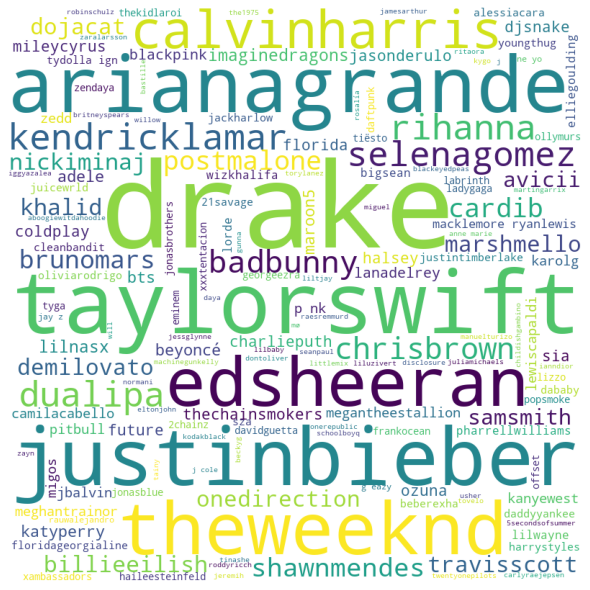

In [ ]:
from wordcloud import WordCloud, STOPWORDS
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                min_font_size = 10).generate(" ".join(new_df['artists']))
                # plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

In [ ]:
cv2 = CountVectorizer(max_features=20)
vectors2 = cv2.fit_transform(new_df['artists']).toarray()

In [ ]:
bag_of_words2 = pd.DataFrame(vectors2,columns=cv2.get_feature_names())

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
bag_of_words2

,arianagrande,badbunny,billieeilish,brunomars,calvinharris,cardib,chrisbrown,drake,dualipa,edsheeran,justinbieber,kendricklamar,khalid,nickiminaj,postmalone,rihanna,selenagomez,shawnmendes,taylorswift,theweeknd
0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1043,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1044,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1045,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
bag_of_words2['id'] = new_df['id']

In [ ]:
new_df = pd.merge(new_df,bag_of_words2,on="id",how='left')

In [ ]:
new_df.drop('artists',axis=1,inplace=True)

In [ ]:
df = pd.merge(df,new_df,on="id",how='left')

In [ ]:
df.to_csv("cleaned_dataset2.csv")

Data Cleaning and EDA

In [ ]:
df

,id,name,artists,artistid,explicit,popularity,durationms,year,danceability,acousticness,...,justinbieber,kendricklamar,khalid,nickiminaj,postmalone,rihanna,selenagomez,shawnmendes,taylorswift,theweeknd
0,3w3y8KPTfNeOKPiqUTakBh,Locked out of Heaven,['Bruno Mars'],0du5cEVh5yTK9QJze8zA0C,False,84,233478,2012,0.726,0.04900,...,0,0,0,0,0,0,0,0,0,0
1,3TGRqZ0a2l1LRblBkJoaDx,Call Me Maybe,['Carly Rae Jepsen'],6sFIWsNpZYqfjUpaCgueju,False,69,193400,2012,0.783,0.01140,...,0,0,0,0,0,0,0,0,0,0
2,7a86XRg84qjasly9f6bPSD,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']",5nCi3BB41mBaMH9gfr6Su0,False,70,250626,2012,0.378,0.02000,...,0,0,0,0,0,0,0,0,0,0
3,1z9kQ14XBSN0r2v6fx4IdG,Diamonds,['Rihanna'],5pKCCKE2ajJHZ9KAiaK11H,False,67,225146,2012,0.564,0.00125,...,0,0,0,0,0,1,0,0,0,0
4,3GZD6HmiNUhxXYf8Gch723,Lost,['Frank Ocean'],2h93pZq0e7k5yf4dywlkpM,True,81,234093,2012,0.913,0.02720,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,2g6tReTlM2Akp41g0HaeXN,Die Hard,"['Kendrick Lamar', 'Blxst', 'Amanda Reifer']",2YZyLoL8N0Wb9xBt1NhZWg,True,76,239026,2022,0.775,0.31900,...,0,1,0,0,0,0,0,0,0,0
1043,4pi1G1x8tl9VfdD9bL3maT,Big Energy,['Latto'],3MdXrJWsbVzdn6fe5JYkSQ,True,65,172540,2022,0.937,0.04530,...,0,0,0,0,0,0,0,0,0,0
1044,3LtpKP5abr2qqjunvjlX5i,Doja,['Central Cee'],5H4yInM5zmHqpKIoMNAx4r,True,84,97392,2022,0.911,0.38000,...,0,0,0,0,0,0,0,0,0,0
1045,3XOalgusokruzA5ZBA2Qcb,pushin P (feat. Young Thug),"['Gunna', 'Future', 'Young Thug']",2hlmm7s2ICUX0LVIhVFlZQ,True,74,136266,2022,0.773,0.00783,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1047 entries, 0 to 1046
Data columns (total 42 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                1047 non-null   object 
 1   name              1047 non-null   object 
 2   artists           1047 non-null   object 
 3   artistid          1047 non-null   object 
 4   explicit          1047 non-null   bool   
 5   popularity        1047 non-null   int64  
 6   durationms        1047 non-null   int64  
 7   year              1047 non-null   int64  
 8   danceability      1047 non-null   float64
 9   acousticness      1047 non-null   float64
 10  energy            1047 non-null   float64
 11  instrumentalness  1047 non-null   float64
 12  liveness          1047 non-null   float64
 13  loudness          1047 non-null   float64
 14  speechiness       1047 non-null   float64
 15  tempo             1047 non-null   float64
 16  valence           1047 non-null   float64


In [ ]:
df.describe()

,popularity,durationms,year,danceability,acousticness,energy,instrumentalness,liveness,loudness,speechiness,...,justinbieber,kendricklamar,khalid,nickiminaj,postmalone,rihanna,selenagomez,shawnmendes,taylorswift,theweeknd
count,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,...,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000,1047.000000
mean,69.967526,213523.424069,2017.000000,0.673441,0.183539,0.656849,0.009023,0.169228,-6.016196,0.099338,...,0.025788,0.017192,0.011461,0.011461,0.013372,0.016237,0.015282,0.012416,0.025788,0.021012
std,12.959006,40094.487641,3.181567,0.133961,0.222627,0.163356,0.066264,0.127036,2.115036,0.093456,...,0.164496,0.130048,0.106493,0.106493,0.114915,0.126446,0.122730,0.110788,0.158578,0.143494
min,0.000000,97392.000000,2012.000000,0.188000,0.000013,0.051900,0.000000,0.021000,-21.107000,0.023200,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,66.000000,189043.000000,2014.000000,0.591000,0.022750,0.552000,0.000000,0.092650,-7.079000,0.041400,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,72.000000,210746.000000,2017.000000,0.686000,0.089500,0.674000,0.000000,0.118000,-5.680000,0.058900,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,77.000000,232093.000000,2020.000000,0.772000,0.258000,0.785000,0.000043,0.203500,-4.584500,0.108000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,94.000000,613026.000000,2022.000000,0.965000,0.978000,0.972000,0.896000,0.979000,-1.702000,0.530000,...,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
df['explicit'].value_counts()

False    697
True     350
Name: explicit, dtype: int64

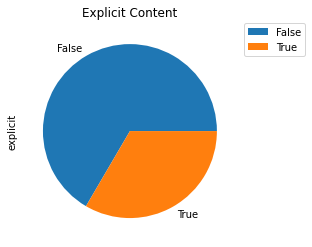

In [ ]:
import matplotlib.pyplot as plt 
ax = df['explicit'].value_counts().plot(kind="pie", legend=True, title='Explicit Content')
ax.legend(bbox_to_anchor=(1, 1.02), loc='upper left')
plt.show()

In [ ]:
df.columns

Index(['id', 'name', 'artists', 'artistid', 'explicit', 'popularity',
       'durationms', 'year', 'danceability', 'acousticness', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence', 'dancepop', 'edm', 'pop', 'poprap', 'rap', 'arianagrande',
       'badbunny', 'billieeilish', 'brunomars', 'calvinharris', 'cardib',
       'chrisbrown', 'drake', 'dualipa', 'edsheeran', 'justinbieber',
       'kendricklamar', 'khalid', 'nickiminaj', 'postmalone', 'rihanna',
       'selenagomez', 'shawnmendes', 'taylorswift', 'theweeknd'],
      dtype='object')

In [ ]:
df

,id,name,artists,artistid,explicit,popularity,durationms,year,danceability,acousticness,...,justinbieber,kendricklamar,khalid,nickiminaj,postmalone,rihanna,selenagomez,shawnmendes,taylorswift,theweeknd
0,3w3y8KPTfNeOKPiqUTakBh,Locked out of Heaven,['Bruno Mars'],0du5cEVh5yTK9QJze8zA0C,False,84,233478,2012,0.726,0.04900,...,0,0,0,0,0,0,0,0,0,0
1,3TGRqZ0a2l1LRblBkJoaDx,Call Me Maybe,['Carly Rae Jepsen'],6sFIWsNpZYqfjUpaCgueju,False,69,193400,2012,0.783,0.01140,...,0,0,0,0,0,0,0,0,0,0
2,7a86XRg84qjasly9f6bPSD,We Are Young (feat. Janelle Monáe),"['fun.', 'Janelle Monáe']",5nCi3BB41mBaMH9gfr6Su0,False,70,250626,2012,0.378,0.02000,...,0,0,0,0,0,0,0,0,0,0
3,1z9kQ14XBSN0r2v6fx4IdG,Diamonds,['Rihanna'],5pKCCKE2ajJHZ9KAiaK11H,False,67,225146,2012,0.564,0.00125,...,0,0,0,0,0,1,0,0,0,0
4,3GZD6HmiNUhxXYf8Gch723,Lost,['Frank Ocean'],2h93pZq0e7k5yf4dywlkpM,True,81,234093,2012,0.913,0.02720,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1042,2g6tReTlM2Akp41g0HaeXN,Die Hard,"['Kendrick Lamar', 'Blxst', 'Amanda Reifer']",2YZyLoL8N0Wb9xBt1NhZWg,True,76,239026,2022,0.775,0.31900,...,0,1,0,0,0,0,0,0,0,0
1043,4pi1G1x8tl9VfdD9bL3maT,Big Energy,['Latto'],3MdXrJWsbVzdn6fe5JYkSQ,True,65,172540,2022,0.937,0.04530,...,0,0,0,0,0,0,0,0,0,0
1044,3LtpKP5abr2qqjunvjlX5i,Doja,['Central Cee'],5H4yInM5zmHqpKIoMNAx4r,True,84,97392,2022,0.911,0.38000,...,0,0,0,0,0,0,0,0,0,0
1045,3XOalgusokruzA5ZBA2Qcb,pushin P (feat. Young Thug),"['Gunna', 'Future', 'Young Thug']",2hlmm7s2ICUX0LVIhVFlZQ,True,74,136266,2022,0.773,0.00783,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df2 = df.drop(['id','artists','name','artistid'],axis=1)

TypeError: ignored

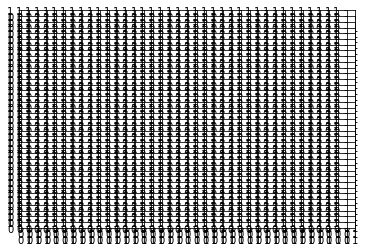

In [ ]:
pd.plotting.scatter_matrix(df2, alpha=0.2)

In [ ]:
bag_of_words

,dancepop,edm,pop,poprap,rap,id
0,1,0,1,0,0,3w3y8KPTfNeOKPiqUTakBh
1,1,0,1,0,0,3TGRqZ0a2l1LRblBkJoaDx
2,0,0,0,0,0,7a86XRg84qjasly9f6bPSD
3,1,0,1,0,0,1z9kQ14XBSN0r2v6fx4IdG
4,0,0,1,0,0,3GZD6HmiNUhxXYf8Gch723
...,...,...,...,...,...,...
1042,0,0,0,0,1,0ARKW62l9uWIDYMZTUmJHF
1043,0,0,1,0,1,1ri9ZUkBJVFUdgwzCnfcYs
1044,0,0,0,0,0,7mFj0LlWtEJaEigguaWqYh
1045,0,0,0,0,1,76YSWx6L6FNsuaP6GWBb8P


In [ ]:
!pip install wordcloud

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
for i in df2.columns:
  print(i)

explicit
popularity
durationms
year
danceability
acousticness
energy
instrumentalness
liveness
loudness
speechiness
tempo
valence
dancepop
edm
pop
poprap
rap
arianagrande
badbunny
billieeilish
brunomars
calvinharris
cardib
chrisbrown
drake
dualipa
edsheeran
justinbieber
kendricklamar
khalid
nickiminaj
postmalone
rihanna
selenagomez
shawnmendes
taylorswift
theweeknd


In [ ]:
df['popularity']

0       84
1       69
2       70
3       67
4       81
        ..
1095    76
1096    65
1097    84
1098    74
1099    77
Name: popularity, Length: 1047, dtype: int64

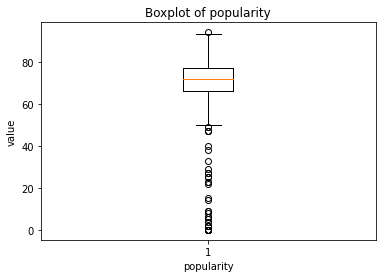

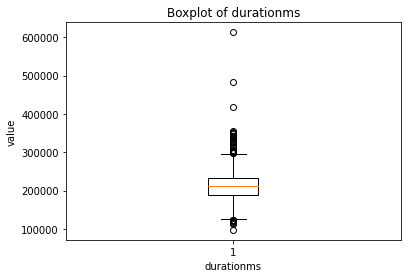

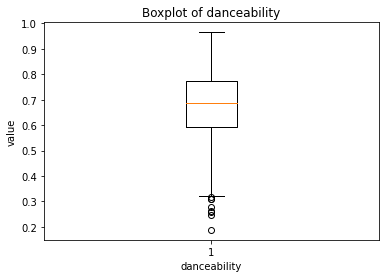

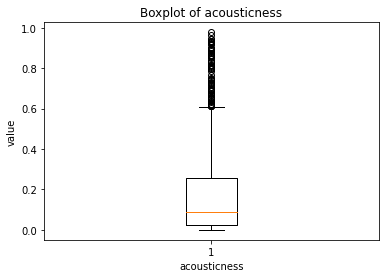

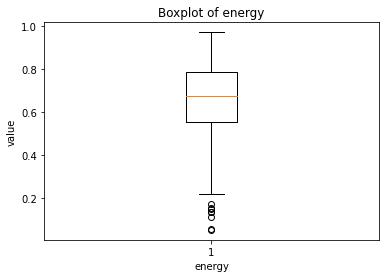

...

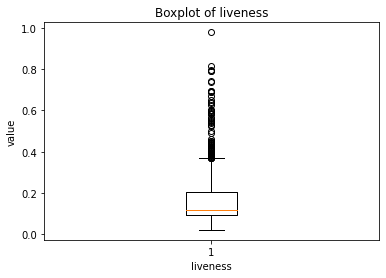

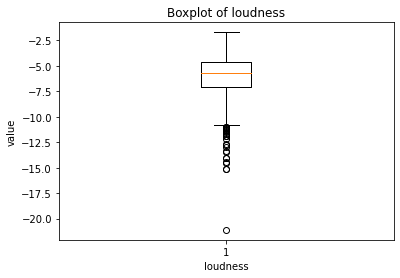

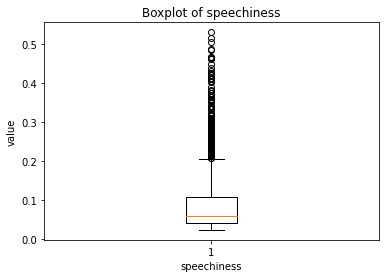

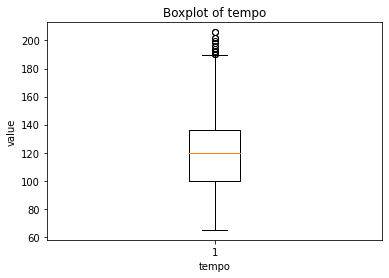

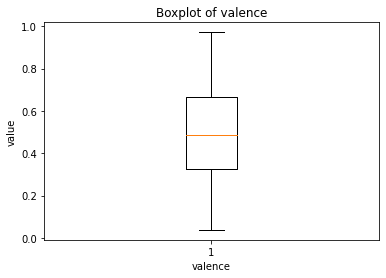

In [ ]:
audio_features = ["popularity","durationms","danceability","acousticness","energy","instrumentalness","liveness","loudness","speechiness","tempo","valence"]
for i in audio_features:
  plt.boxplot(df[i])
  plt.xlabel(i)
  plt.ylabel("value")
  plt.title(f"Boxplot of {i}")
  plt.savefig(f"Boxplot_{i}.jpg")
  plt.show()

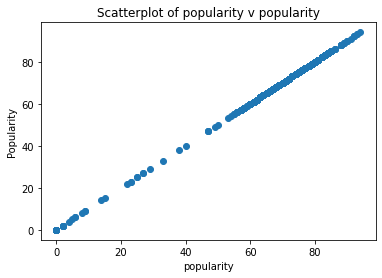

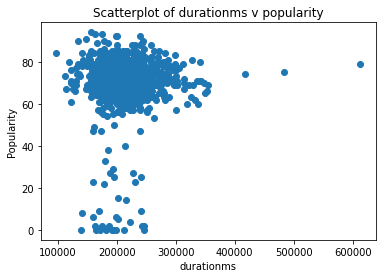

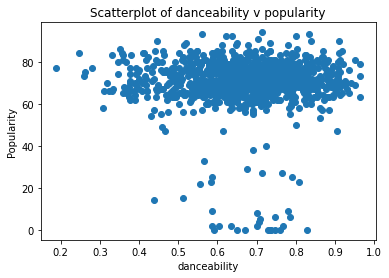

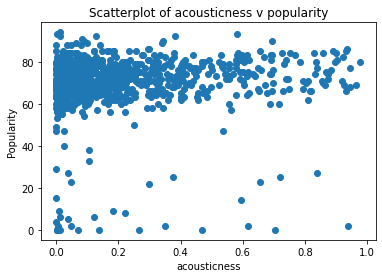

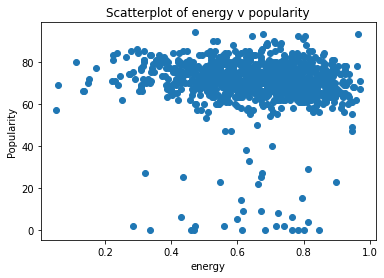

...

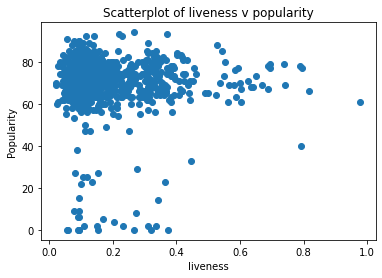

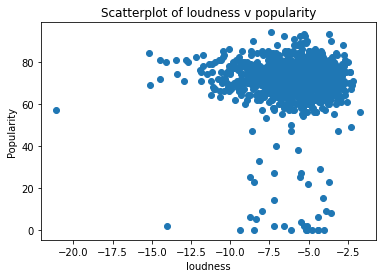

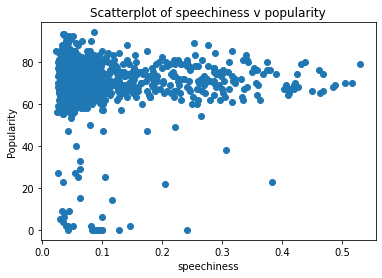

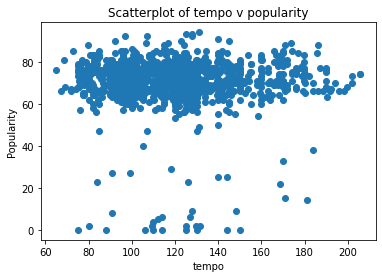

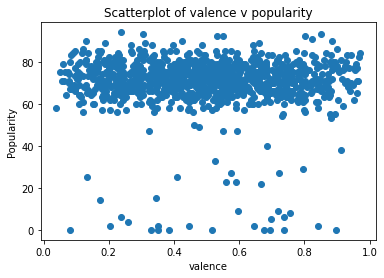

In [ ]:
audio_features = ["popularity","durationms","danceability","acousticness","energy","instrumentalness","liveness","loudness","speechiness","tempo","valence"]
for i in audio_features:
  plt.scatter(df[i], df['popularity'])
  
  plt.xlabel(i)
  plt.ylabel("Popularity")
  plt.title(f"Scatterplot of {i} v popularity")
  plt.savefig(f"Scatterplot_{i}.jpg")
  plt.show()

In [ ]:
!pip3 freeze > requirements.txt

In [2]:
df = pd.read_csv('final_dataset.csv')

In [4]:
df2 = df.groupby('year')

In [6]:
df.groupby('year')['durationms'].mean()

year
2012    227974.84
2013    232210.33
2014    226951.78
2015    220346.25
2016    221364.69
2017    221447.32
2018    208138.44
2019    198174.84
2020    196555.81
2021    196633.06
2022    198276.94
Name: durationms, dtype: float64

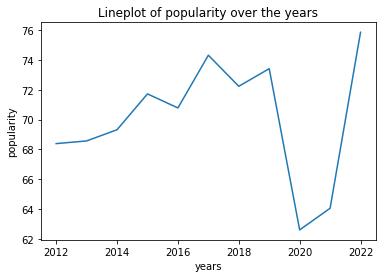

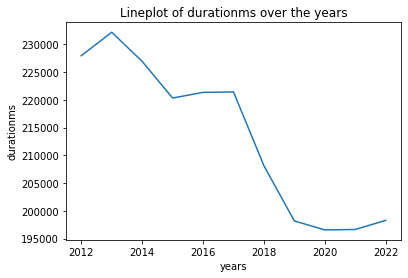

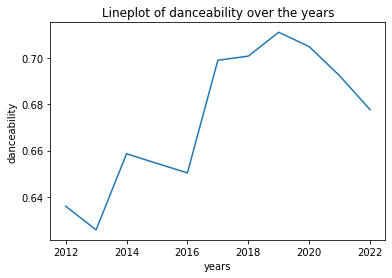

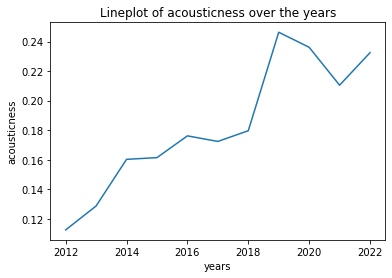

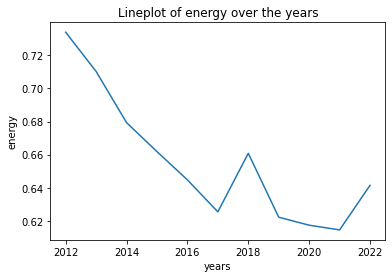

...

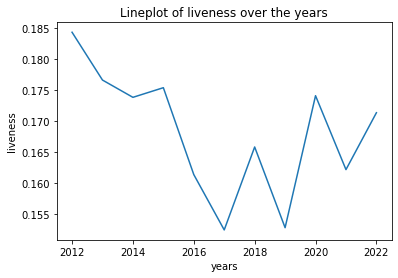

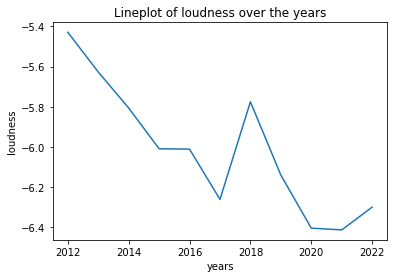

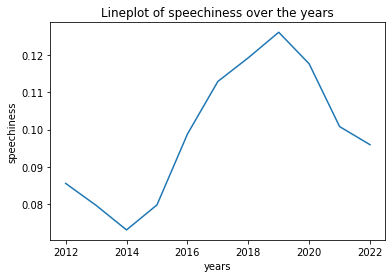

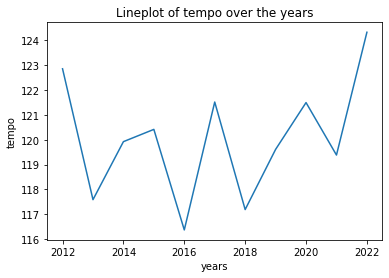

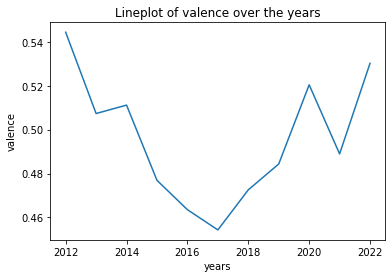

In [10]:
audio_features = ["popularity","durationms","danceability","acousticness","energy","instrumentalness","liveness","loudness","speechiness","tempo","valence"]
for i in audio_features:
  data = df.groupby('year')[i].mean()
  plt.plot(data)
  
  plt.xlabel("years")
  plt.ylabel(i)
  plt.title(f"Lineplot of {i} over the years")
  plt.savefig(f"Lineplot_{i}.jpg")
  plt.show()